In [1]:
import torch
from PIL import Image
import random
from diffusers import (
    DiffusionPipeline,
    AutoencoderKL,
    StableDiffusionControlNetPipeline,
    ControlNetModel,
    StableDiffusionLatentUpscalePipeline,
    StableDiffusionImg2ImgPipeline,
    StableDiffusionControlNetImg2ImgPipeline,
    DPMSolverMultistepScheduler,  # <-- Added import
    EulerDiscreteScheduler  # <-- Added import
)
import time


/Users/lsb/jupyterlab/.direnv/python-3.10.12/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
preferred_dtype = torch.float32
preferred_device = "cpu"
BASE_MODEL = "SG161222/Realistic_Vision_V5.1_noVAE"
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse", torch_dtype=preferred_dtype).to(preferred_device)
controlnet = ControlNetModel.from_pretrained("monster-labs/control_v1p_sd15_qrcode_monster", torch_dtype=preferred_dtype).to(preferred_device)
main_pipe = StableDiffusionControlNetPipeline.from_pretrained(
    BASE_MODEL,
    controlnet=controlnet,
    vae=vae,
    safety_checker=None,
    torch_dtype=preferred_dtype,
).to(preferred_device)
image_pipe = StableDiffusionControlNetImg2ImgPipeline(**main_pipe.components)

Loading pipeline components...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 16.60it/s]
You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet_img2img.StableDiffusionControlNetImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [3]:
SAMPLER_MAP = {
    "DPM++ Karras SDE": lambda config: DPMSolverMultistepScheduler.from_config(config, use_karras=True, algorithm_type="sde-dpmsolver++"),
    "Euler": lambda config: EulerDiscreteScheduler.from_config(config),
}


In [4]:
def center_crop_resize(img, output_size=(512, 512)):
    width, height = img.size

    # Calculate dimensions to crop to the center
    new_dimension = min(width, height)
    left = (width - new_dimension)/2
    top = (height - new_dimension)/2
    right = (width + new_dimension)/2
    bottom = (height + new_dimension)/2

    # Crop and resize
    img = img.crop((left, top, right, bottom))
    img = img.resize(output_size)

    return img

In [5]:
def common_upscale(samples, width, height, upscale_method, crop=False):
        if crop == "center":
            old_width = samples.shape[3]
            old_height = samples.shape[2]
            old_aspect = old_width / old_height
            new_aspect = width / height
            x = 0
            y = 0
            if old_aspect > new_aspect:
                x = round((old_width - old_width * (new_aspect / old_aspect)) / 2)
            elif old_aspect < new_aspect:
                y = round((old_height - old_height * (old_aspect / new_aspect)) / 2)
            s = samples[:,:,y:old_height-y,x:old_width-x]
        else:
            s = samples

        return torch.nn.functional.interpolate(s, size=(height, width), mode=upscale_method)

In [6]:
def upscale(samples, upscale_method, scale_by):
        #s = samples.copy()
        width = round(samples["images"].shape[3] * scale_by)
        height = round(samples["images"].shape[2] * scale_by)
        s = common_upscale(samples["images"], width, height, upscale_method, "disabled")
        return (s)

In [9]:
def inference(
    control_image: Image.Image,
    prompt: str,
    negative_prompt: str,
    guidance_scale: float = 8.0,
    controlnet_conditioning_scale: float = 1,
    control_guidance_start: float = 1,    
    control_guidance_end: float = 1,
    upscaler_strength: float = 0.5,
    seed: int = -1,
    sampler = "DPM++ Karras SDE",
):
    start_time = time.time()
    start_time_struct = time.localtime(start_time)
    start_time_formatted = time.strftime("%H:%M:%S", start_time_struct)
    print(f"Inference started at {start_time_formatted}")
    
    # Generate the initial image
    #init_image = init_pipe(prompt).images[0]

    # Rest of your existing code
    control_image_small = center_crop_resize(control_image)
    control_image_large = center_crop_resize(control_image, (1024, 1024))

    main_pipe.scheduler = SAMPLER_MAP[sampler](main_pipe.scheduler.config)
    my_seed = random.randint(0, 2**32 - 1) if seed == -1 else seed
    generator = torch.Generator(device=preferred_device).manual_seed(my_seed)
    
    out = main_pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        image=control_image_small,
        guidance_scale=float(guidance_scale),
        controlnet_conditioning_scale=float(controlnet_conditioning_scale),
        generator=generator,
        control_guidance_start=float(control_guidance_start),
        control_guidance_end=float(control_guidance_end),
        num_inference_steps=15,
        output_type="latent"
    )
    upscaled_latents = upscale(out, "nearest-exact", 2)
    out_image = image_pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        control_image=control_image_large,        
        image=upscaled_latents,
        guidance_scale=float(guidance_scale),
        generator=generator,
        num_inference_steps=20,
        strength=upscaler_strength,
        control_guidance_start=float(control_guidance_start),
        control_guidance_end=float(control_guidance_end),
        controlnet_conditioning_scale=float(controlnet_conditioning_scale)
    )
    end_time = time.time()
    end_time_struct = time.localtime(end_time)
    end_time_formatted = time.strftime("%H:%M:%S", end_time_struct)
    print(f"Inference ended at {end_time_formatted}, taking {end_time-start_time}s")
    return out_image["images"][0]

Inference started at 22:53:17


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:11<00:00, 37.17s/it]


Inference ended at 23:00:51, taking 454.1022398471832s


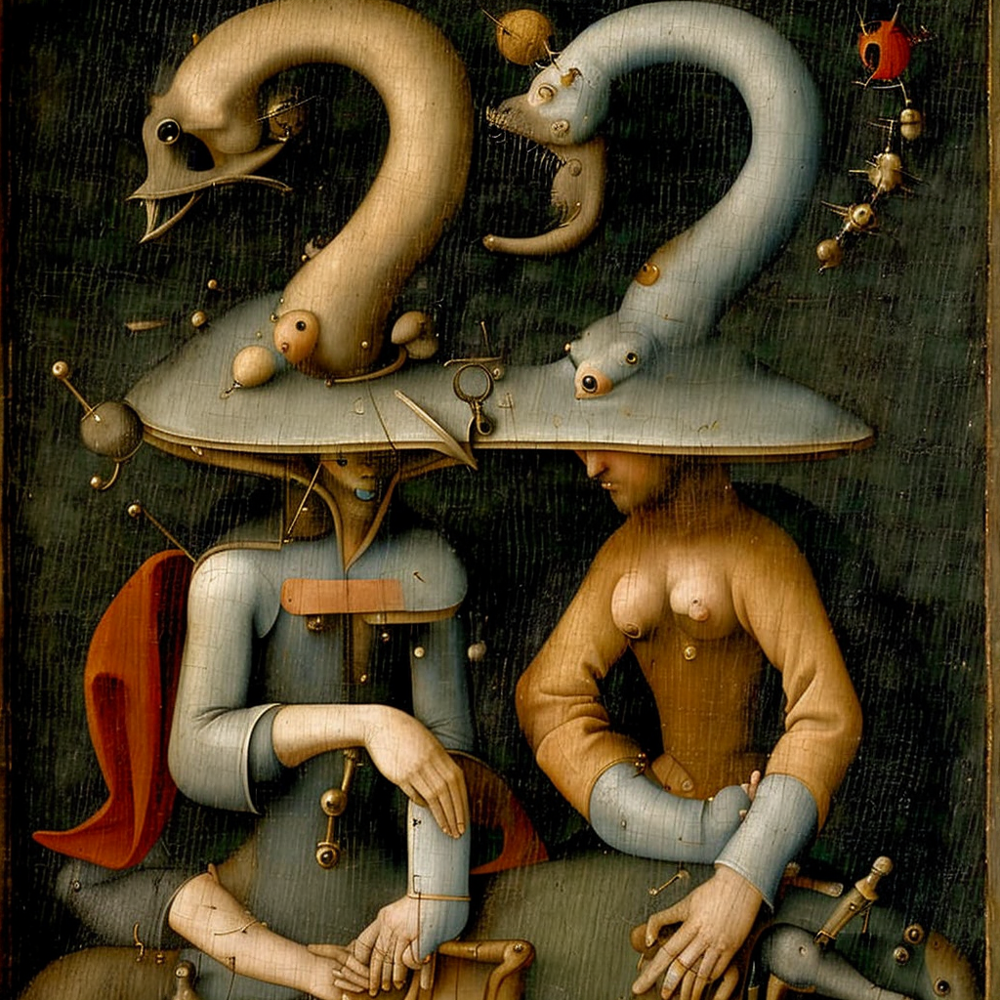

In [10]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="detail from hieronymus bosch painting",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:02:13


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:15<00:00, 37.55s/it]


Inference ended at 23:09:55, taking 461.4226417541504s


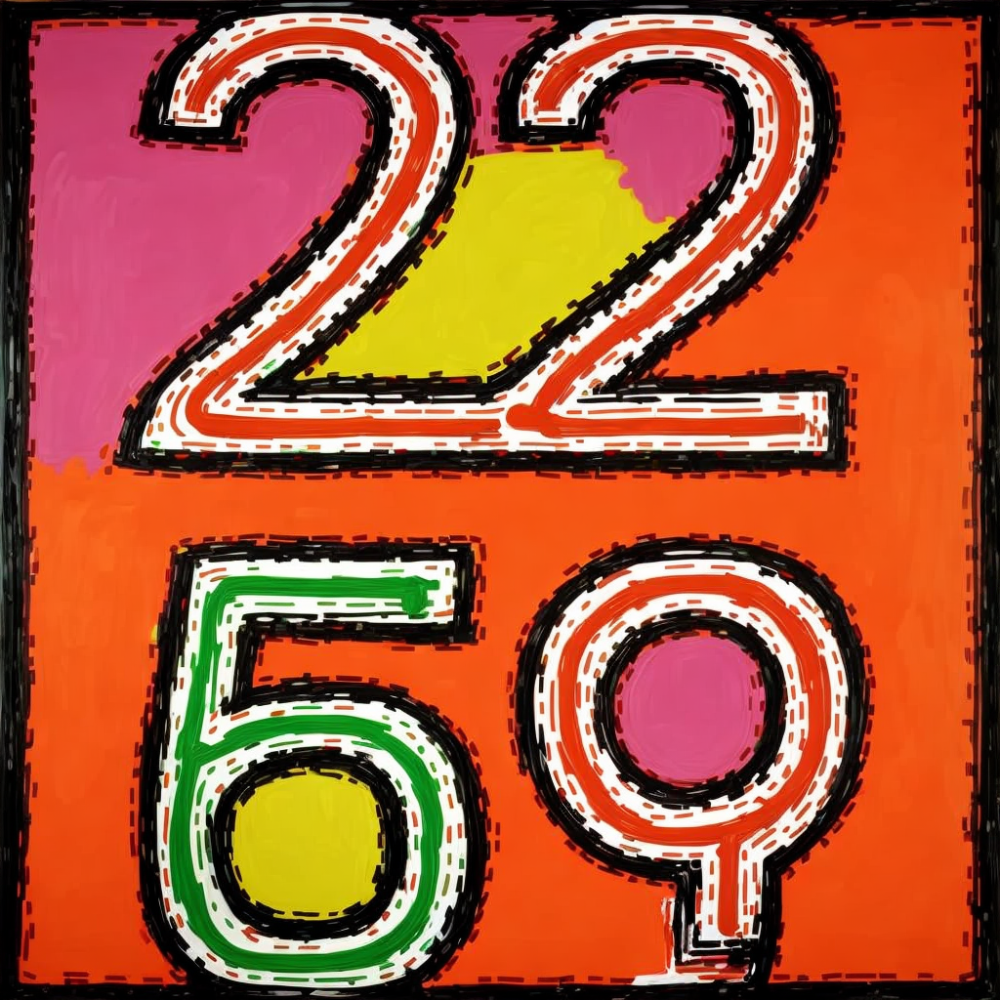

In [11]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="keith haring painting",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:10:37


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:13<00:00, 37.31s/it]


Inference ended at 23:18:14, taking 456.98797512054443s


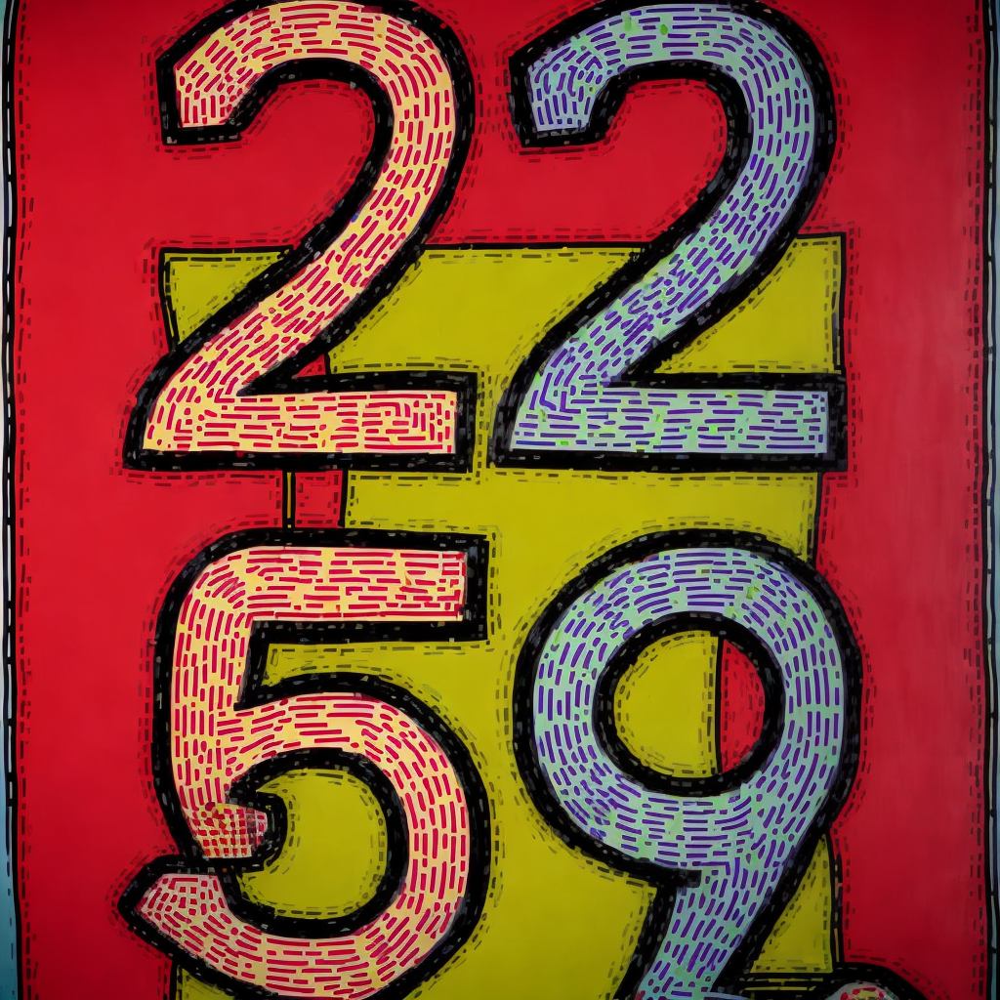

In [12]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="details of dogs dancing with men in a keith haring painting",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:24:49


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:15<00:00, 37.54s/it]


Inference ended at 23:32:30, taking 461.2400040626526s


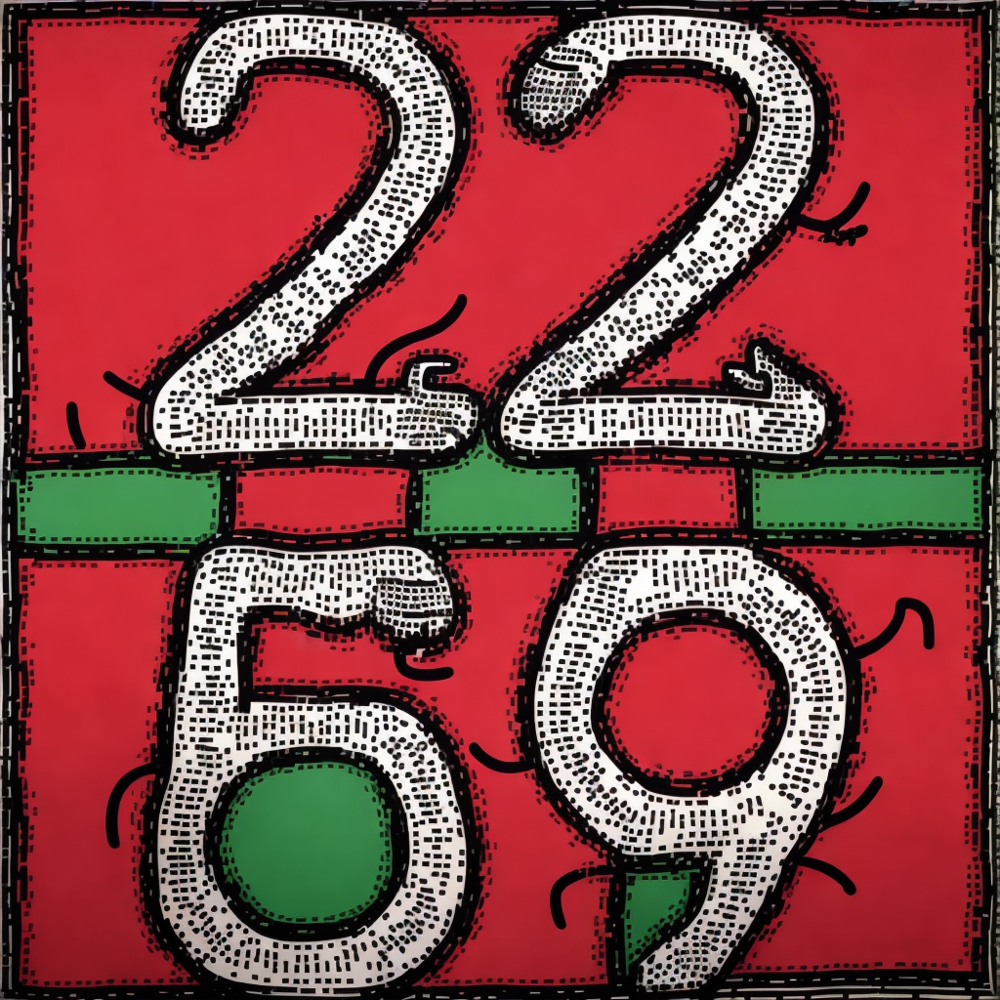

In [13]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="keith haring dogs dancing",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:32:30


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:15<00:00, 37.52s/it]


Inference ended at 23:40:10, taking 459.95558404922485s


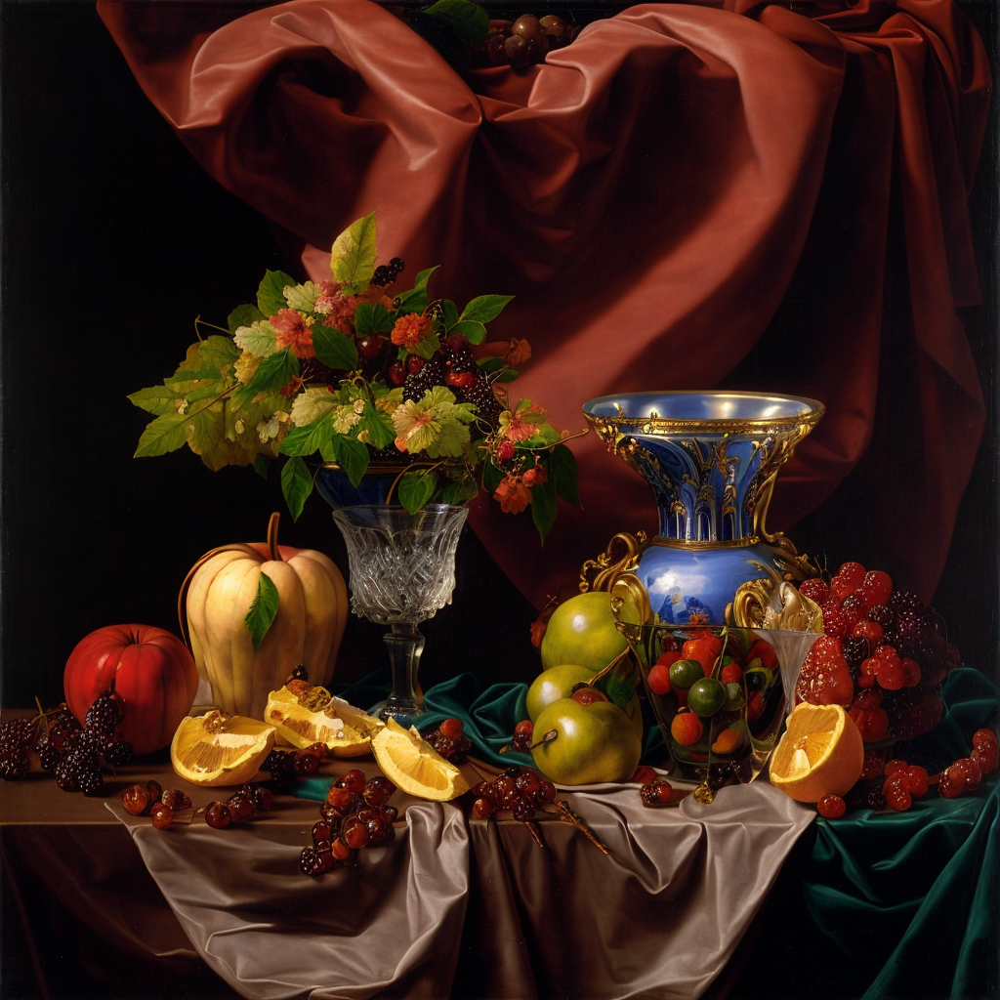

In [14]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="renaissance still life",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:40:11


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [07:02<00:00, 42.25s/it]


Inference ended at 23:48:40, taking 508.99926590919495s


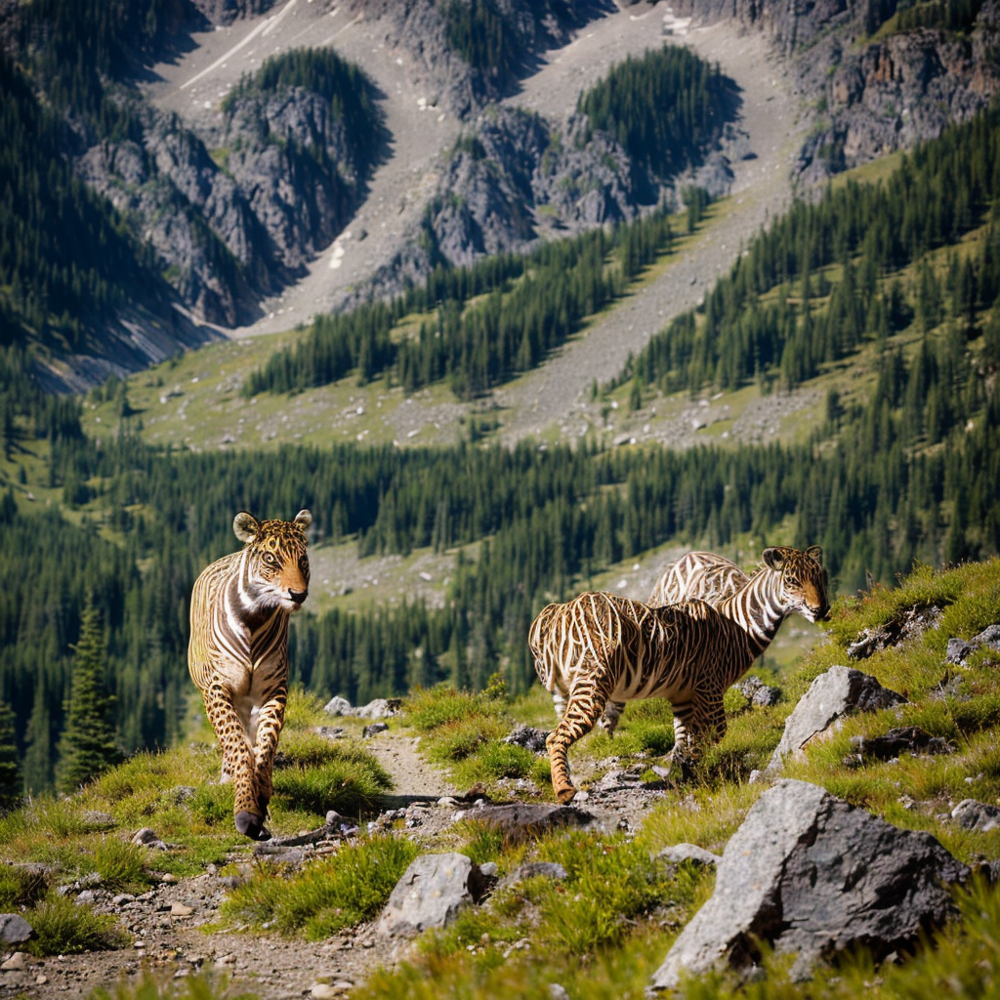

In [15]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="wild animals in the mountains, award winning photo",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:48:40


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:13<00:00, 37.40s/it]


Inference ended at 23:56:18, taking 458.4022741317749s


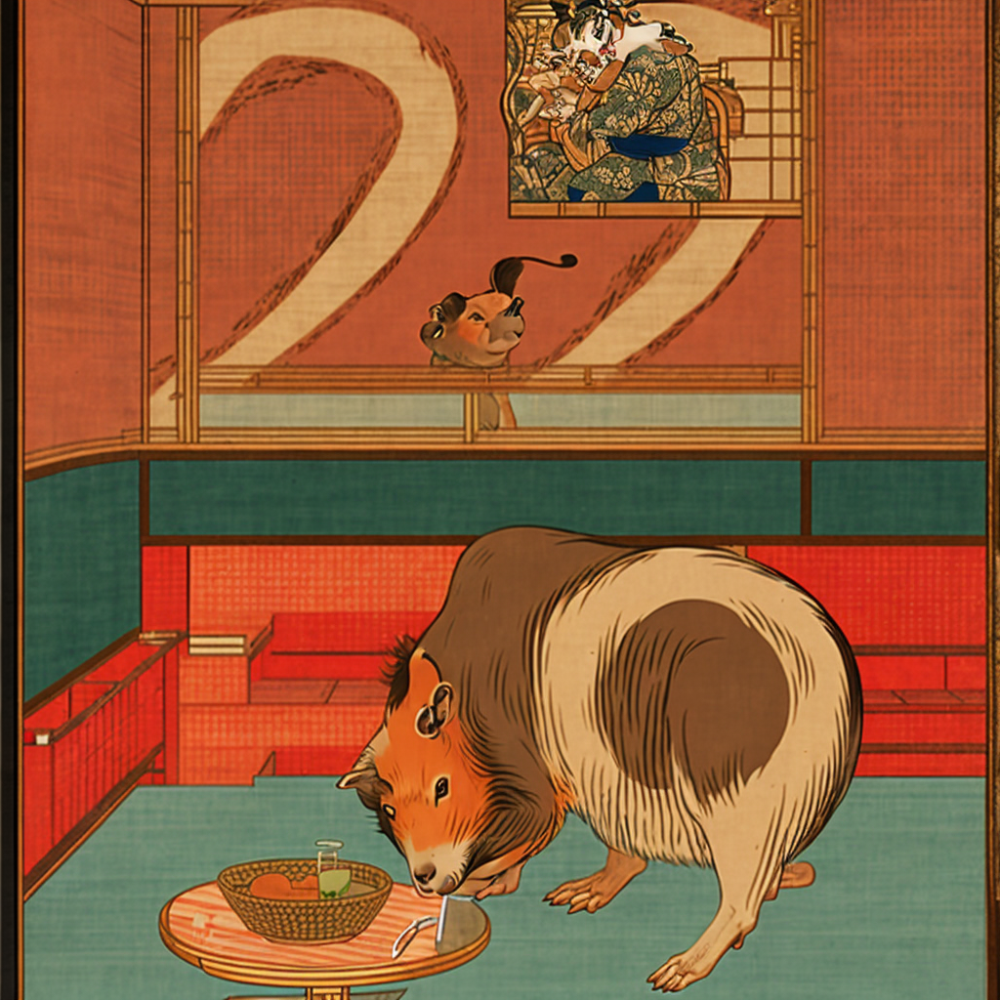

In [16]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="ukiyo-e image of a capybara in a cafe",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 23:56:18


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:12<00:00, 37.24s/it]


Inference ended at 00:03:57, taking 458.905394077301s


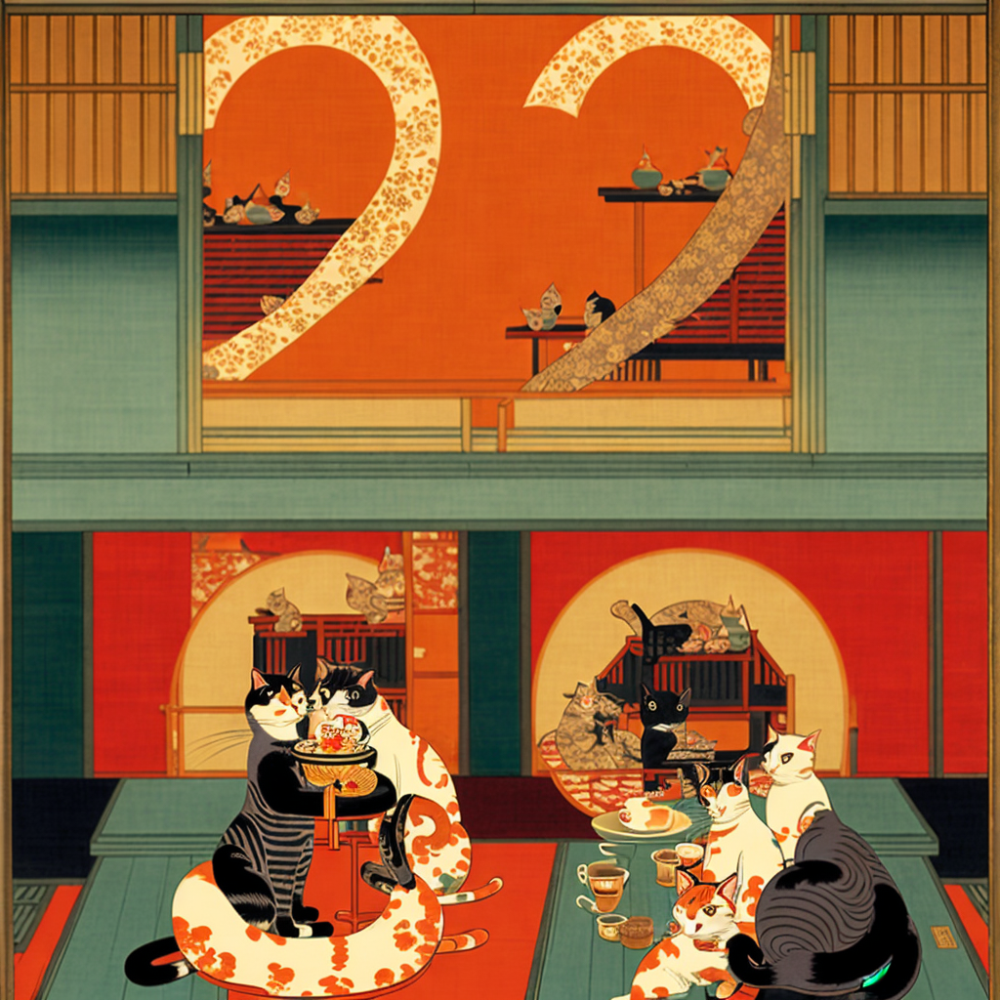

In [17]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="ukiyo-e image of cats in a cafe at golden hour",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 00:03:57


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:12<00:00, 37.29s/it]


Inference ended at 00:11:34, taking 456.53292989730835s


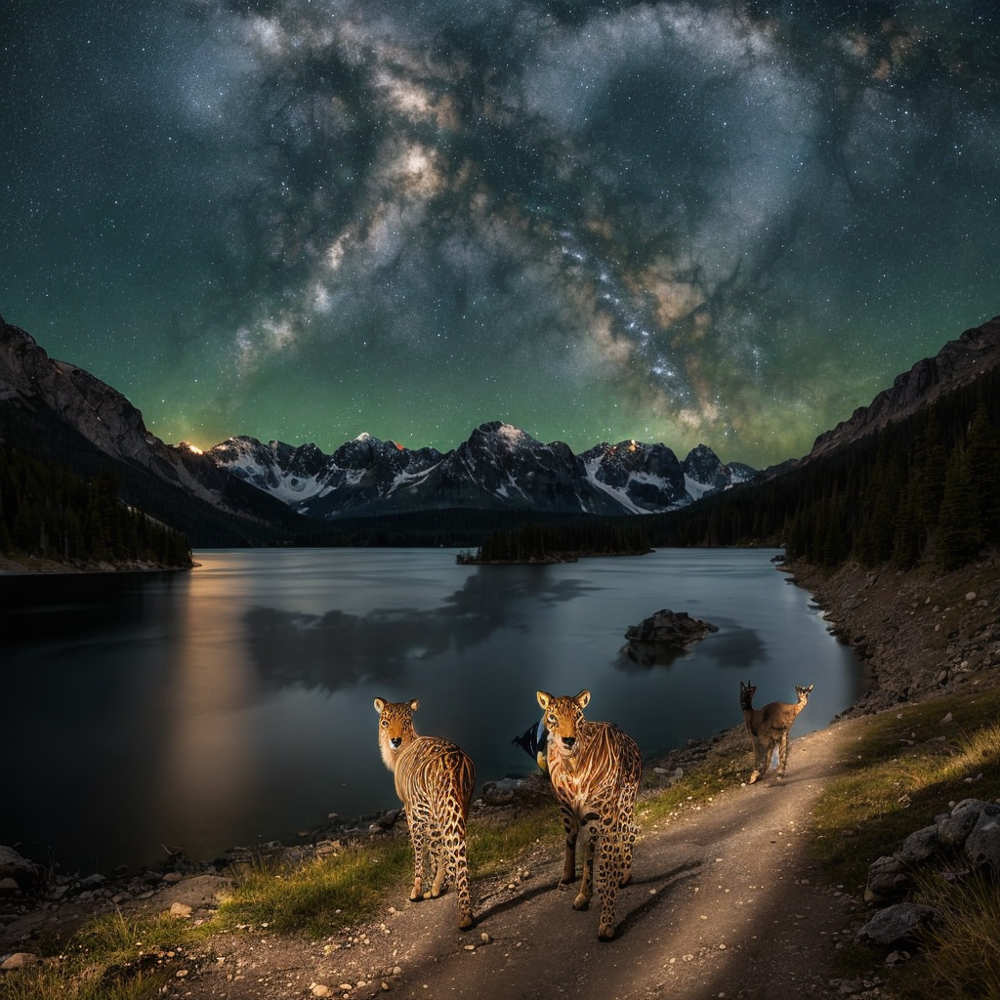

In [18]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="wild animals in the mountains near a lake, award winning photo at night",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 00:11:34


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:14<00:00, 37.43s/it]


Inference ended at 00:19:15, taking 460.710825920105s


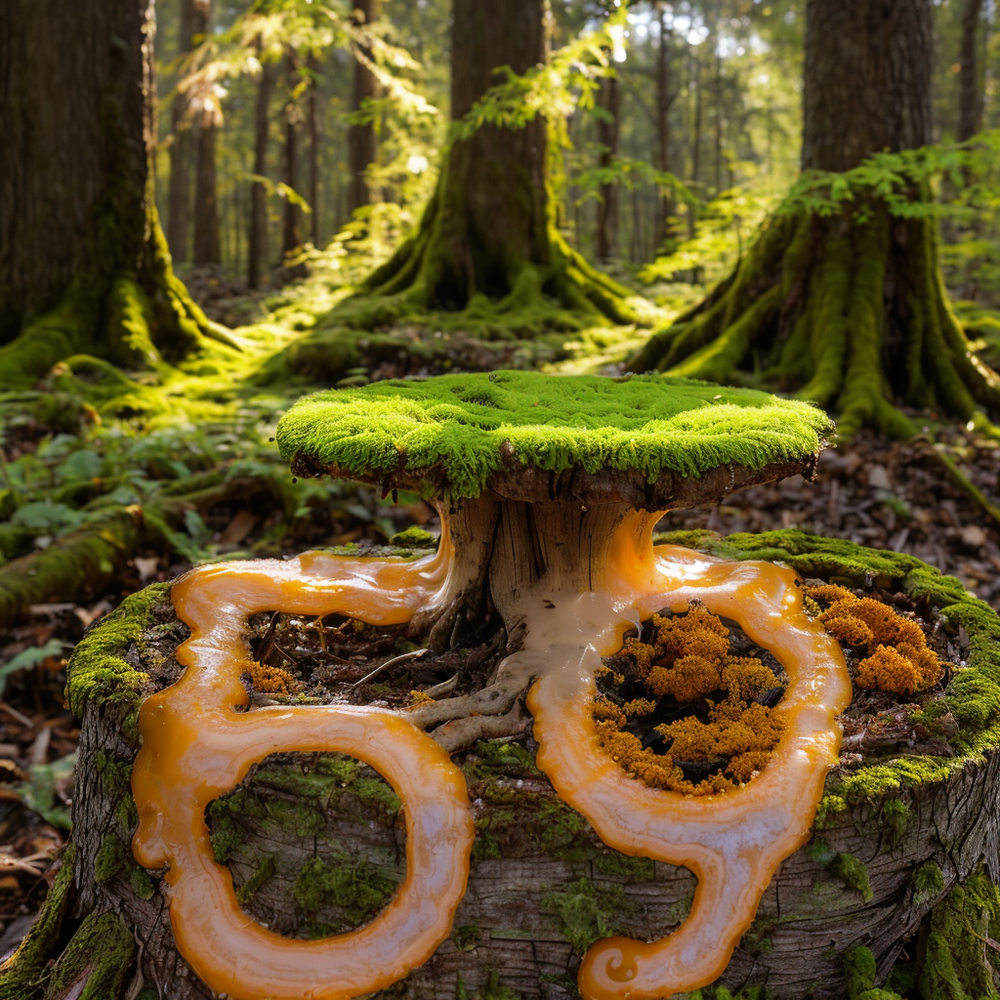

In [19]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="fungus and slime molds on a tree stump in the forest, golden hour, award winning photo",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img

Inference started at 00:19:15


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10/10 [06:17<00:00, 37.72s/it]


Inference ended at 00:26:55, taking 460.3423340320587s


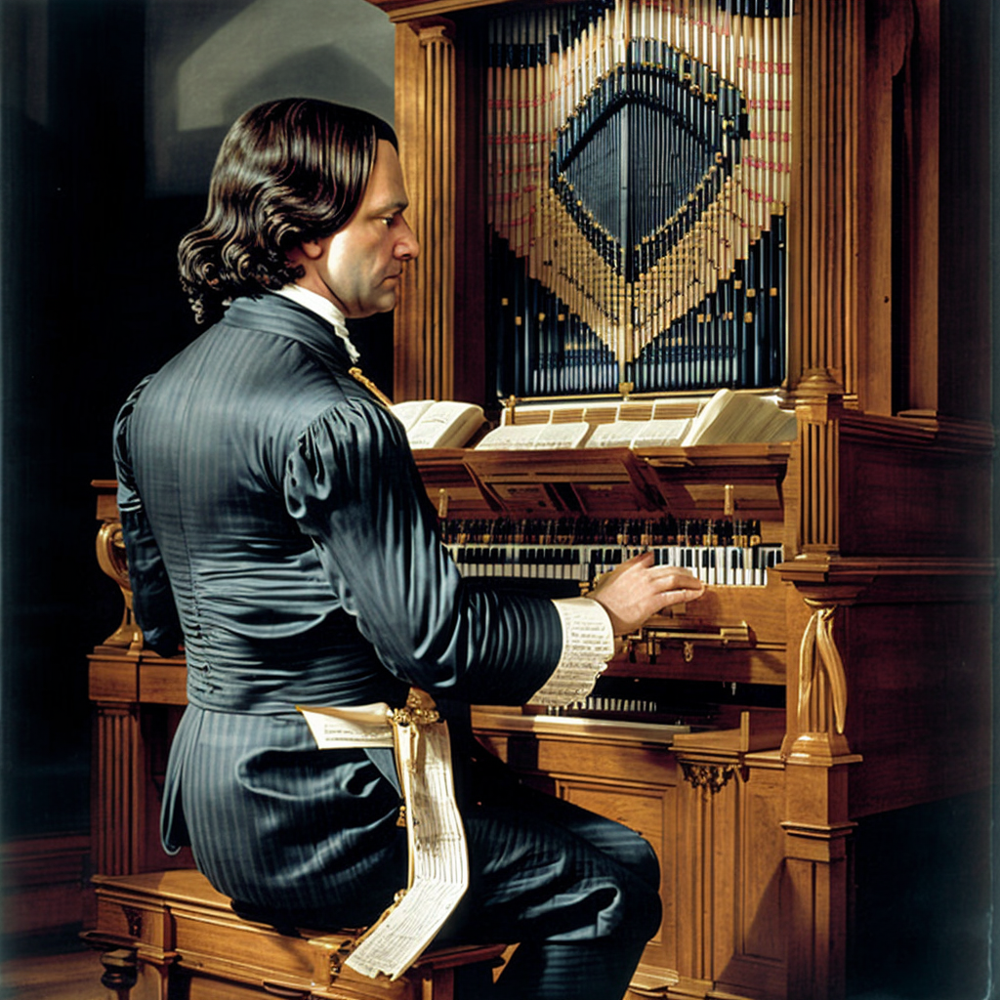

In [20]:
img = inference(
    control_image=Image.open("2259.png"),
    prompt="Johann Sebastian Bach playing the organ",
    negative_prompt="low quality, ugly",
    controlnet_conditioning_scale=0.8,
    control_guidance_start=0,
    control_guidance_end=1,
    seed=123456789,
)
img